**Name:** Trần Đức Thuỵ

**Gmail:** tdthuycg2001@gmail.com

**Address:** Ho Chi Minh City

# IMPORT LIBRARIES

In [29]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
import plotly.express as px
from sklearn.metrics import mean_squared_error
sns.set()

# MSN Data

## Read data

In [30]:
# Đọc dữ liệu
msn_data = pd.read_csv("MSN.csv")
msn_data

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,MSN,12/25/2017 9:15,73.1,73.1,73.1,73.1,4210,0
1,MSN,12/25/2017 9:16,73.0,73.0,73.0,73.0,5000,0
2,MSN,12/25/2017 9:18,73.5,73.5,73.5,73.5,210,0
3,MSN,12/25/2017 9:20,73.2,73.5,73.1,73.1,2050,0
4,MSN,12/25/2017 9:21,73.0,73.0,73.0,73.0,1380,0
...,...,...,...,...,...,...,...,...
135349,MSN,12/22/2020 14:23,82.8,82.8,82.8,82.8,700,0
135350,MSN,12/22/2020 14:24,82.7,82.8,82.7,82.8,4660,0
135351,MSN,12/22/2020 14:25,82.8,82.8,82.8,82.8,50,0
135352,MSN,12/22/2020 14:27,82.8,82.8,82.8,82.8,300,0


- Dữ liệu có tổng cộng: **135354 dòng và 8 cột**

In [31]:
# Kiểm tra dòng trùng
print("Number of duplicated rows: ",np.sum(msn_data.duplicated()))

Number of duplicated rows:  0


- Dữ liệu không có dòng trùng nhau

In [32]:
# Kiểm tra kiểu dữ liệu
msn_data.dtypes

Ticker            object
Date/Time         object
Open             float64
High             float64
Low              float64
Close            float64
Volume             int64
Open Interest      int64
dtype: object

In [33]:
# Chuyển đổi kiểu dữ liệu cột Date/Time từ object sang datetime
msn_data["Date/Time"] = pd.to_datetime(msn_data["Date/Time"], format="%m/%d/%Y %H:%M")
msn_data["Date/Time"]

0        2017-12-25 09:15:00
1        2017-12-25 09:16:00
2        2017-12-25 09:18:00
3        2017-12-25 09:20:00
4        2017-12-25 09:21:00
                 ...        
135349   2020-12-22 14:23:00
135350   2020-12-22 14:24:00
135351   2020-12-22 14:25:00
135352   2020-12-22 14:27:00
135353   2020-12-22 14:46:00
Name: Date/Time, Length: 135354, dtype: datetime64[ns]

## Descriptive Statistics

### Numerical data 

In [34]:
nume_df = msn_data.select_dtypes(include=np.number)
missing_percentage = np.sum(nume_df.isna(), axis=0)*100/len(msn_data)
mean_sr = np.mean(nume_df, axis=0)
std_sr = np.std(nume_df, axis =0)
median_sr = np.median(nume_df, axis=0)
max_sr = np.max(nume_df, axis=0)
min_sr = np.min(nume_df,axis=0)
statistic_df = pd.DataFrame({"Missing Percentage": missing_percentage,"Mean":mean_sr, "Standard Deviation": std_sr, "Median": median_sr, "Max":max_sr, "Min": min_sr})
statistic_df.T

,Open,High,Low,Close,Volume,Open Interest
Missing Percentage,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.0
Mean,74.878809,74.931668,74.834625,74.880759,5.683578e+03,0.0
Standard Deviation,15.418017,15.426897,15.412620,15.418800,2.798503e+04,0.0
Median,79.100000,79.200000,79.100000,79.100000,2.000000e+03,0.0
Max,117.800000,118.000000,117.700000,118.000000,3.300680e+06,0.0
Min,46.500000,46.500000,46.400000,46.400000,1.000000e+01,0.0


**Nhận xét:**
- Các cột thuộc tính đều không có dữ liệu bị thiếu
- Không có các dòng dữ liệu trùng nhau
- Các cột dữ liệu đều có giá trị dương, không có giá trị không hợp lệ (invalid data)
- Cột Open Interest có các giá trị đều là 0.0, khi thiết kế mô hình dự đoán có thể cân nhắc loại bỏ cột này

### Categorical data

In [35]:
# Kiểm tra khoảng của dữ liệu thời gian
oldest_dt = msn_data["Date/Time"].sort_values().values[0]
latest_dt = msn_data["Date/Time"].sort_values().values[-1]
oldest_dt, latest_dt

(numpy.datetime64('2017-12-25T09:15:00.000000000'),
 numpy.datetime64('2020-12-22T14:46:00.000000000'))

**Do thị trường chứng khoán mở phiên vào 9:00 và đóng cửa lúc 15:00 nên cần kiểm tra thời gian có thoả mãn điều kiện này hay không?**
- Hàm *check_datetime* sẽ kiểm tra từng giá trị trong thuộc tính Date/Time, trả về True nếu thoả điều kiện ngược lại trả về False
- Biến *number_valid_value* là số những dữ liệu thoả điều kiện
- Cuối cùng sẽ in ra số dữ liệu không thoả mãn: *len(data) - number_valid_value*

In [36]:
def check_datetime(datetime):
    time = datetime.time()
    start = dt.time(9,0)
    end = dt.time(15,0)
    if time>=start and time<=end:
        return True
    return False

number_valid_value = np.sum(msn_data["Date/Time"].apply(check_datetime))

print("\nSo du lieu thoi gian khong hop le: ", len(msn_data) - number_valid_value, "\n")


So du lieu thoi gian khong hop le:  0 



In [37]:
cate_df = msn_data.select_dtypes(include=["object","datetime"])
missing_percentage = np.sum(cate_df.isna(), axis=0)*100/len(msn_data)
unique_sr = cate_df.nunique(axis=0)
statistic_df = pd.DataFrame({"Missing Percentage": missing_percentage,"Num_unique": unique_sr})
statistic_df

,Missing Percentage,Num_unique
Ticker,0.0,1
Date/Time,0.0,135354


**Nhận xét:**
- Các nhãn cổ phiếu đều đồng nhất (mã MSN)
- Các giá trị date/time là phân biệt, không có giá trị thời gian trùng lặp
- Không có dữ liệu không hợp lệ, các giao dịch trong ngày đều nằm trong khoảng thời gian **9:00 - 15:00**
- Dữ liệu từ **25/12/2018 - 22/12/2020**

## Data Visualization

In [38]:
# Biểu đồ thể hiện biến động giá mở cửa và đóng cửa theo thời gian 
fig1 = px.line(msn_data, x="Date/Time", y="Open",color_discrete_sequence=["green"], title="Open price by date")
fig2 = px.line(msn_data, x="Date/Time", y="Close",color_discrete_sequence=["red"], title="Close price by date")
fig1.update_layout(
    autosize=False,
    width=1000,
    height=500)
fig2.update_layout(
    autosize=False,
    width=1000,
    height=500)
fig1.show()
fig2.show()

In [39]:
fig3 = px.bar(msn_data.groupby(msn_data["Date/Time"].dt.date)["Volume"].mean().reset_index(), x="Date/Time", y="Volume",color_discrete_sequence=["red"],title="Volume by date")
fig3.update_layout(
    autosize=False,
    width=1000,
    height=600)
fig3.show()

In [40]:
mean_squared_error(msn_data["Open"], msn_data["Close"])

0.02866167457186346

**Nhận xét:**
- Biến thiên giá Open và Close có sự chênh lệch không nhiều, độ đo MSE= 0.315184 với 125309 mẫu 


**Trực quan hoá yếu tố Trend, Seasonality, Noise của chuỗi thời gian**

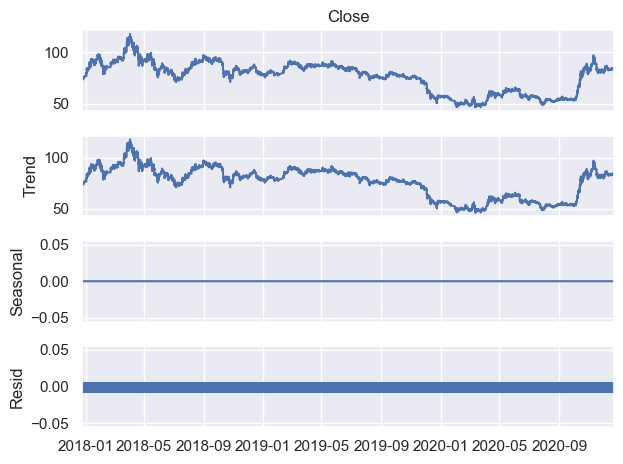

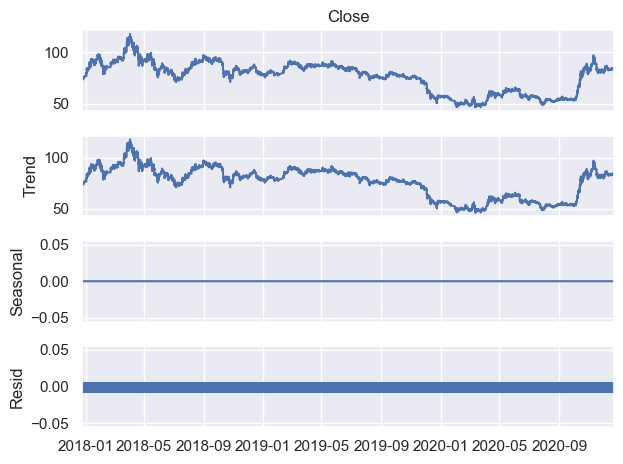

In [41]:
from statsmodels.tsa.seasonal import seasonal_decompose
from dateutil.parser import parse

df = msn_data.copy()
df = df.set_index(["Date/Time"])

#Ta xem giá trị chuỗi thời gian là tổng các yếu tố Trend, Seasonality và Noise


result_add = seasonal_decompose(df["Close"], model='additive',extrapolate_trend='freq', period=1)

result_add.plot()


**Nhận xét:**
- Giá cổ phiếu không có tính seasonality 

## Data Exploration

In [42]:
# Số ngày giao dịch
len(msn_data.groupby(msn_data["Date/Time"].dt.date))

748

In [43]:
#Tổng lượng cổ phiếu giao dịch
total_volume = np.sum(msn_data["Volume"])
total_volume

769294980

In [44]:
# Xem ngày có giá đóng cửa thấp nhất
msn_data.groupby(msn_data["Date/Time"].dt.date).apply(lambda x: x.sort_values("Date/Time").iloc[-1]).sort_values("Close").head(10)

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
Date/Time,,,,,,,,
2020-03-04,MSN,2020-03-04 14:46:00,49.0,49.0,49.0,49.0,211590,0
2020-02-28,MSN,2020-02-28 14:46:00,49.0,49.0,49.0,49.0,572380,0
2020-03-02,MSN,2020-03-02 14:46:00,49.0,49.0,49.0,49.0,401620,0
2020-03-03,MSN,2020-03-03 14:46:00,49.0,49.0,49.0,49.0,223110,0
2020-03-31,MSN,2020-03-31 14:46:00,49.0,49.0,49.0,49.0,1165450,0
2020-03-26,MSN,2020-03-26 14:46:00,49.0,49.0,49.0,49.0,1526670,0
2020-03-24,MSN,2020-03-24 14:46:00,49.1,49.1,49.1,49.1,1924960,0
2020-03-30,MSN,2020-03-30 14:46:00,49.1,49.1,49.1,49.1,747590,0
2020-03-25,MSN,2020-03-25 14:46:00,49.1,49.1,49.1,49.1,1238510,0


In [45]:
# Xem ngày có giá đóng cửa cao nhất
msn_data.groupby(msn_data["Date/Time"].dt.date).apply(lambda x: x.sort_values("Date/Time", ascending=False).iloc[-1]).sort_values("Close",
                                                                                                                                 ascending=False).head(10)

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
Date/Time,,,,,,,,
2018-04-03,MSN,2018-04-03 09:15:00,115.0,115.0,115.0,115.0,14120,0
2018-04-02,MSN,2018-04-02 09:15:00,113.0,113.5,113.0,113.5,7430,0
2018-04-04,MSN,2018-04-04 09:15:00,113.0,113.1,113.0,113.1,47150,0
2018-04-05,MSN,2018-04-05 09:15:00,112.0,112.0,112.0,112.0,22350,0
2018-04-06,MSN,2018-04-06 09:15:00,109.5,112.0,109.5,112.0,13230,0
2018-03-29,MSN,2018-03-29 09:15:00,111.5,111.5,111.5,111.5,24180,0
2018-03-27,MSN,2018-03-27 09:15:00,111.0,111.0,111.0,111.0,11060,0
2018-03-30,MSN,2018-03-30 09:15:00,109.5,109.9,109.5,109.9,20880,0
2018-04-10,MSN,2018-04-10 09:15:00,109.0,109.0,109.0,109.0,10570,0


In [46]:
# Xem ngày có lượng giao dịch nhiều nhất
msn_data.groupby(msn_data["Date/Time"].dt.date)["Volume"].sum().sort_values(ascending=False)

Date/Time
2020-10-29    6707870
2020-10-16    6539150
2020-10-07    6435850
2020-10-12    5818700
2020-10-15    5698130
               ...   
2019-06-13     111480
2019-07-05      96600
2019-04-12      95630
2019-05-06      90180
2019-04-19      57480
Name: Volume, Length: 748, dtype: int64

In [47]:
# Kiểm tra tháng có ngày khối lượng giao dịch cao nhất
df = msn_data.groupby(msn_data["Date/Time"].dt.date).agg({"Close":"mean","Volume":"sum"})
df = df.reset_index()
df["Date/Time"] = pd.to_datetime(df["Date/Time"])
df.loc[(df["Date/Time"].dt.month==10) & (df["Date/Time"].dt.year==2020),:]

,Date/Time,Close,Volume
689,2020-10-01,54.143005,964220
690,2020-10-02,54.045567,1483120
691,2020-10-05,54.603814,3268020
692,2020-10-06,56.732009,4400570
693,2020-10-07,59.281018,6435850
694,2020-10-08,61.540133,4846470
695,2020-10-09,64.120000,5339660
696,2020-10-12,67.326311,5818700
697,2020-10-13,70.279018,4664240
698,2020-10-14,74.545885,5066890


In [48]:
# Thống kê cho từng năm
msn_data.iloc[:,1:].groupby(by=msn_data["Date/Time"].dt.year).mean()

,Date/Time,Open,High,Low,Close,Volume,Open Interest
Date/Time,,,,,,,
2017,2017-12-27 04:30:30.446096640,74.935688,74.955204,74.918030,74.938290,3221.022305,0.0
2018,2018-07-07 08:48:50.839662336,88.076487,88.124329,88.030683,88.080030,4687.452092,0.0
2019,2019-07-12 04:08:17.626029056,78.690909,78.716679,78.665538,78.692818,3755.587806,0.0
2020,2020-07-02 02:54:15.399305472,61.076675,61.155130,61.018866,61.077343,8030.616512,0.0


**Nhận xét:**
- Tổng số ngày là **748 ngày, với 769.294.980 triệu cổ phiếu** đã được giao dịch. Có thời điểm giá cổ phiếu đạt **115.000đ/cp**, là mức giá cao nhất trong được thiết lập vào **02/04/2018**. Sau đó vào ngày **04/03/2020,** giá cổ phiếu giảm sâu về mức **49.000đ/cp**. Các khoảng thời gian khác cổ phiếu biến động quanh vùng giá trung bình khoảng 65.000 - 70.000đ.cp
- Khối lượng giao dịch lớn tập trung vào cuối năm 2019. Ngày **29/10/2020** có khối lượng giao dịch cao nhất lên tới  **6.707.870 cổ phiếu**. Trước đó, các phiên giao dịch đều có khối lượng rất lớn, giá tăng mạnh chứng tỏ có dòng tiền lớn đổ vào.


## ARIMA MODEL

In [49]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA

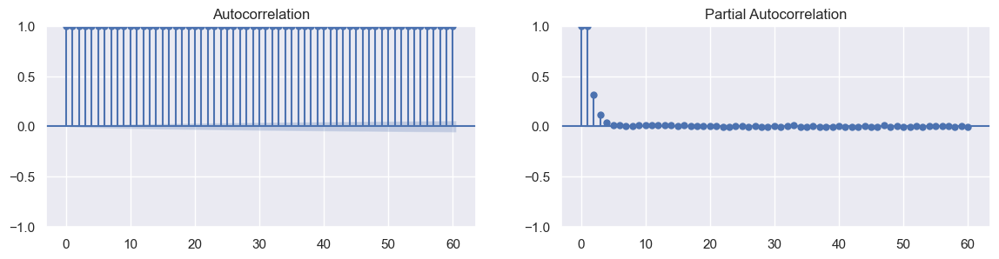

In [50]:
fig, axes = plt.subplots(1,2,figsize=(14,3), dpi= 100)
plot_acf(msn_data["Close"].values.tolist(), lags=60,ax=axes[0])
plot_pacf(msn_data["Close"].values.tolist(), lags=60, ax=axes[1]);

In [51]:
from pmdarima.arima import auto_arima
grid_arima = auto_arima(msn_data["Close"].values, start_p=0, start_q=0, max_p=2, max_q=2,
                       max_d=2, d=0, start_P = 0, seasonal=False, ic=["aic"], trace=True)

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=1558088.459, Time=0.86 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=5.18 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=inf, Time=7.33 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=-46662.971, Time=4.96 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=-46661.341, Time=9.09 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=-46661.317, Time=7.45 sec
 ARIMA(0,0,2)(0,0,0)[0]             : AIC=1192255.928, Time=24.53 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=3.17 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-46659.248, Time=12.38 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-46667.302, Time=15.17 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=940409.519, Time=13.98 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=5.17 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-46665.711, Time=23.77 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-46665.890, Time=18.41 sec
 ARIMA(0,0,0)(0,0,0)[0] i

In [52]:
grid_arima = auto_arima(msn_data["Close"].values, start_p=0, start_q=0, max_p=2, max_q=2,
                       d=1, start_P = 0, seasonal=False, ic=["aic"], trace=True)

Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-30486.658, Time=8.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-44666.708, Time=5.82 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-46674.838, Time=10.34 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-30488.643, Time=4.06 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-46673.241, Time=23.93 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-46673.248, Time=15.70 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-46670.912, Time=28.84 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-46676.797, Time=6.79 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-46675.201, Time=8.06 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-46675.208, Time=5.19 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-44668.679, Time=2.68 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-46672.871, Time=14.60 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0]          
Total fit time: 134.265 seconds


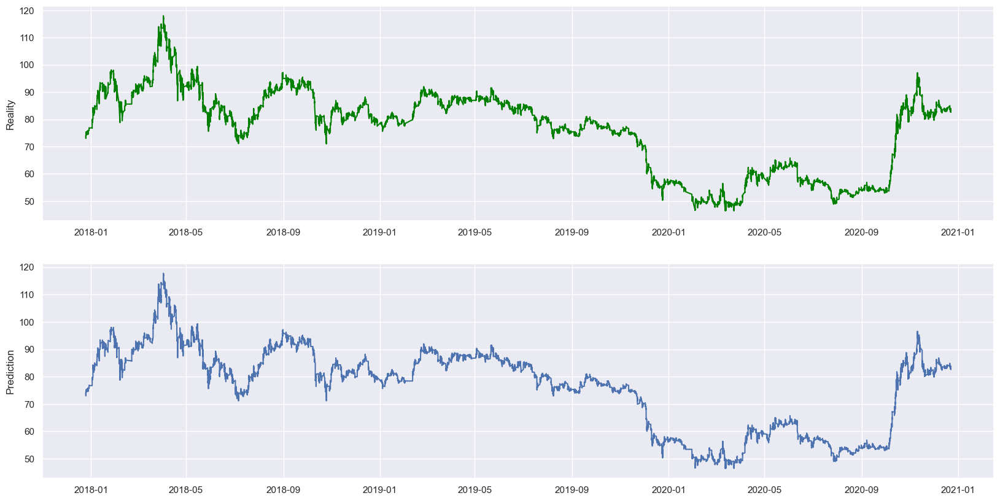

In [58]:
arima = ARIMA(msn_data["Close"].values, order = (0,1,1))
model = arima.fit()
predict = model.predict()
predict[0] = predict[1]
fig, axes = plt.subplots(2,1,figsize=(20,10))
axes[1].plot(msn_data["Date/Time"],predict)
axes[1].set_ylabel("Prediction")
axes[0].plot(msn_data["Date/Time"], msn_data["Close"], color="Green")
axes[0].set_ylabel("Reality")
plt.show()

In [56]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:               135354
Model:                 ARIMA(0, 1, 1)   Log Likelihood               23340.399
Date:                Tue, 14 Nov 2023   AIC                         -46676.797
Time:                        10:55:16   BIC                         -46657.166
Sample:                             0   HQIC                        -46670.920
                             - 135354                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1         -0.3571      0.001   -483.702      0.000      -0.359      -0.356
sigma2         0.0415   2.99e-05   1387.249      0.000       0.041       0.042
===================================================================================
Ljung-Box (L1) (Q):                   0.05   Jarque-Bera (JB):          16977921.60
Prob(Q):                              0.82   Prob(JB):                         0.00
Heteroskedasticity (H):               0.72   Skew:                             0.06
Prob(H) (two-sided):                  0.00   Kurtosis:                        57.87
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

**Nhận xét:**
- Mô hình ARIMA(1,0,1) cho kết quả gần khớp với dữ liệu thực
- Độ đo AIC = -46676.797
- Các tham số của mô hình có p_value <0.05 => đều có ý nghĩa về mặt thống kê